In [1]:
import scanpy as sc, pandas as pd, numpy as np
import anndata
import os


/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/leidenalg/VertexPartition.py:388: SyntaxWarning: invalid escape sequence '\m'
  """ Implements modularity. This quality function is well-defined only for positive edge weights.
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/leidenalg/VertexPartition.py:761: SyntaxWarning: invalid escape sequence '\m'
  """ Implements Reichardt and Bornholdt's Potts model with a configuration null model.
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/leidenalg/Optimiser.py:7: SyntaxWarning: invalid escape sequence '\g'
  """ Class for doing community detection using the Leiden algorithm.
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/leidenalg/Optimiser.py:305: SyntaxWarning: invalid escape sequence '\s'
  """ Optimise the given partitions simultaneously.


In [4]:
fp1_2 = ! ls /home/users/chensj16/s/tmp/yimiao/pool1_2/outs/per_sample_outs/**/count/sample_filtered_feature_bc_matrix.h5
fp6_3 = ! ls /home/users/chensj16/s/tmp/yimiao/pool6_3/outs/per_sample_outs/**/count/sample_filtered_feature_bc_matrix.h5
fp8   = ! ls /home/users/chensj16/oak/analysis-proj/yimiao/pool8/outs/per_sample_outs/**/count/sample_filtered_feature_bc_matrix.h5
fp_list = fp1_2 + fp6_3 + fp8

In [5]:
pool_info   = [os.path.dirname(fp).split('/')[7] for fp in fp_list]
sample_info = [os.path.dirname(fp).split('/')[-2] for fp in fp_list]

for i in range(len(pool_info)):
    print(f"{i},\t {pool_info[i]},\t {sample_info[i]}")

0,	 pool1_2,	 Ctrl_Ecto
1,	 pool1_2,	 Ctrl_Ecto-mTeSR
2,	 pool1_2,	 Ctrl_hPSC
3,	 pool1_2,	 JARID2_Ecto
4,	 pool1_2,	 JARID2_Ecto-mTeSR
5,	 pool1_2,	 JARID2_hPSC
6,	 pool6_3,	 Ctrl_12hEcto
7,	 pool6_3,	 Ctrl_12hEcto-mTeSR
8,	 pool6_3,	 Ctrl_24hEcto
9,	 pool6_3,	 Ctrl_24hEcto-mTeSR
10,	 pool6_3,	 Ctrl_hPSC
11,	 pool6_3,	 H1_12hEcto
12,	 pool6_3,	 H1_12hEcto-mTeSR
13,	 pool6_3,	 H1_24hEcto
14,	 pool6_3,	 H1_24hEcto-mTeSR
15,	 pool6_3,	 H1_hPSC
16,	 pool8,	 12h-Ecto-4_days_mTeSR
17,	 pool8,	 E4T_1
18,	 pool8,	 E4T_2
19,	 pool8,	 E4T_3
20,	 pool8,	 E4T-JARID2-KD
21,	 pool8,	 E4T-SMARCC1-KD
22,	 pool8,	 Ectoderm-BRM014-4T
23,	 pool8,	 Ectoderm-BRM014
24,	 pool8,	 Ectoderm_SMARCC1-Kd
25,	 pool8,	 ET_SMARCC1-KD
26,	 pool8,	 hPSC
27,	 pool8,	 hPSC_SMARCC1-KD


In [6]:
sample_info =[
'Ctrl-E.p1',
'Ctrl-ET.p1',
'Ctrl-hPSC.p1',
'JARID2-E',
'JARID2-ET',
'JARID2-hPSC',
'Ctrl-0.5E',
'Ctrl-0.5ET',
'Ctrl-E.p6',
'Ctrl-ET.p6',
'Ctrl-hPSC.p6',
'H1-0.5E',
'H1-0.5ET',
'H1-E',
'H1-ET',
'H1-hPSC.p6',
'H1-0.5E4T',
'H1-E4T.1',
'H1-E4T.2',
'H1-E4T.3',
'JARID2-E4T',
'SMARCC1-E4T',
'BRM014-E4T',
'BRM014-E',
'SMARCC1-E',
'SMARCC1-ET',
'H1-hPSC.p8',
'SMARCC1-hPSC'
]
background = [s.split('-')[0] for s in sample_info]

import re
treatment = [s.split('-')[1] for s in sample_info]
treatment = [re.sub(r'\.p\d+$', '', s) for s in treatment] # remove .p[digit] suffix
treatment = [re.sub(r'\.\d+$', '', s) for s in treatment]  # remove .[digit] suffix
ectoderm = [1, 1, 0, 1, 1, 0, 0.5, 0.5,1,1,0,
            0.5, 0.5, 1, 1, 0, 0.5, 1, 1, 1,
            1, 1, 1, 1, 1., 1., 0.,0.]

mTeSR =[0, 1, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 1.0,
        0, 1, 0, 4, 4, 4, 4, 4, 4, 4, 0, 0, 1, 0, 0]


In [7]:
sample_meta = pd.DataFrame({'sample_info':sample_info, 'background':background,'treatment':treatment,'ectoderm':ectoderm,'mTeSR':mTeSR })
sample_meta

,sample_info,background,treatment,ectoderm,mTeSR
0,Ctrl-E.p1,Ctrl,E,1.0,0.0
1,Ctrl-ET.p1,Ctrl,ET,1.0,1.0
2,Ctrl-hPSC.p1,Ctrl,hPSC,0.0,0.0
3,JARID2-E,JARID2,E,1.0,0.0
4,JARID2-ET,JARID2,ET,1.0,1.0
5,JARID2-hPSC,JARID2,hPSC,0.0,0.0
6,Ctrl-0.5E,Ctrl,0.5E,0.5,0.0
7,Ctrl-0.5ET,Ctrl,0.5ET,0.5,1.0
8,Ctrl-E.p6,Ctrl,E,1.0,0.0
9,Ctrl-ET.p6,Ctrl,ET,1.0,1.0


In [8]:
adata_list = [sc.read_10x_h5(fp) for fp in fp_list]

for i in range(len(pool_info)):
    adata_list[i].obs['pool']   = pool_info[i]
    adata_list[i].obs['sample'] = sample_info[i]
    adata_list[i].obs['background'] = background[i]
    adata_list[i].obs['treatment']  = treatment[i]
    adata_list[i].obs['ectoderm']   = ectoderm[i]
    adata_list[i].obs['mTeSR']      = mTeSR[i]

/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/anndata/_core/anndata.py:1758: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/anndata/_core/anndata.py

In [9]:
for adata in adata_list:
    adata.var_names_make_unique()
    adata.obs_names_make_unique()
    adata.obs_names = adata.obs['pool']+"|"+adata.obs['sample']+"|"+adata.obs_names 
    
    adata.var["mt"] = adata.var_names.str.startswith("MT-") # mitochondrial genes, "MT-" for human, "Mt-" for mouse
    adata.var["hb"] = adata.var_names.str.contains("^HB[^(P)]") # hemoglobin genes
    sc.pp.calculate_qc_metrics(
        adata, qc_vars=["mt", "hb"], inplace=True, log1p=True
    )
    sc.pp.filter_cells(adata, min_genes=300)
    
    adata.layers["counts"] = adata.X.copy()
    sc.pp.normalize_total(adata)
    sc.pp.log1p(adata)

In [10]:
adata_merged = anndata.concat(adata_list)
adata_merged.obs['batch'] = adata_merged.obs['pool']+'|'+adata_merged.obs['sample']
sc.pp.highly_variable_genes(adata_merged, n_top_genes=1000, batch_key="batch")

In [11]:
import requests
def get_cell_cycle_genes() -> list:
    # Canonical list of cell cycle genes
    url = "https://raw.githubusercontent.com/scverse/scanpy_usage/master/180209_cell_cycle/data/regev_lab_cell_cycle_genes.txt"
    cell_cycle_genes = requests.get(url).text.split("\n")[:-1]
    return cell_cycle_genes

cell_cycle_genes = get_cell_cycle_genes()
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
cell_cycle_genes = [x for x in cell_cycle_genes if x in adata.var_names]
sc.tl.score_genes_cell_cycle(adata_merged, s_genes=s_genes, g2m_genes=g2m_genes, use_raw=False)

In [12]:
adata_merged.obs['ann'] = adata_merged.obs['sample'].copy()
adata_merged.obs['ann'] = adata_merged.obs['ann'].replace(
    {"Ctrl-E.p1"  	: 'differentiated' ,
    "Ctrl-ET.p1"  	: 'mal-reversed' ,
    "Ctrl-hPSC.p1"  : 'hPSC' ,
    "JARID2-E"  	: 'differentiated' ,
    "JARID2-ET"  	: 'reversed' ,
    "JARID2-hPSC"  	: 'hPSC' ,
    "Ctrl-0.5E"  	: 'half-differentiated' ,
    "Ctrl-0.5ET"  	: 'reversed' ,
    "Ctrl-E.p6"  	: 'differentiated' ,
    "Ctrl-ET.p6"  	: 'mal-reversed' ,
    "Ctrl-hPSC.p6"  : 'hPSC' ,
    "H1-0.5E"  		: 'half-differentiated' ,
    "H1-0.5ET"  	: 'reversed' ,
    "H1-E"  		: 'differentiated' ,
    "H1-ET"  		: 'mal-reversed' ,
    "H1-hPSC.p6"  	: 'hPSC' ,
    "H1-0.5E4T"  	: 'super-reversed' ,
    "H1-E4T.1"  	: 'mal-reversed' ,
    "H1-E4T.2"  	: 'mal-reversed' ,
    "H1-E4T.3"  	: 'mal-reversed' ,
    "JARID2-E4T"  	: 'super-reversed' ,
    "SMARCC1-E4T"  	: 'super-reversed' ,
    "BRM014-E4T"  	: 'super-reversed' ,
    "BRM014-E"  	: 'differentiated' ,
    "SMARCC1-E"  	: 'differentiated' ,
    "SMARCC1-ET"  	: 'reversed' ,
    "H1-hPSC.p8"  	: 'hPSC' ,
    "SMARCC1-hPSC"  : 'hPSC' }
)

/tmp/ipykernel_4955/1168085289.py:2: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata_merged.obs['ann'] = adata_merged.obs['ann'].replace(


In [13]:
from scipy.stats import zscore
gene_names = ['NANOG', 'B2M','SOX2','CAV1','CALD1', 'EMP3','VIM','RARRES2','TAGLN','POU5F1','OTX2','CD24','PAX6','SOX1','MESP1','SOX17','FOXA2']
expr = pd.DataFrame(  np.expm1(adata_merged[:, gene_names].X.todense()), columns=gene_names)
expr['celltype'] = adata_merged.obs['sample'].tolist()
expr = expr.groupby("celltype").mean()
expr = np.log1p(expr).T
expr = expr.T.apply(zscore, 0).T

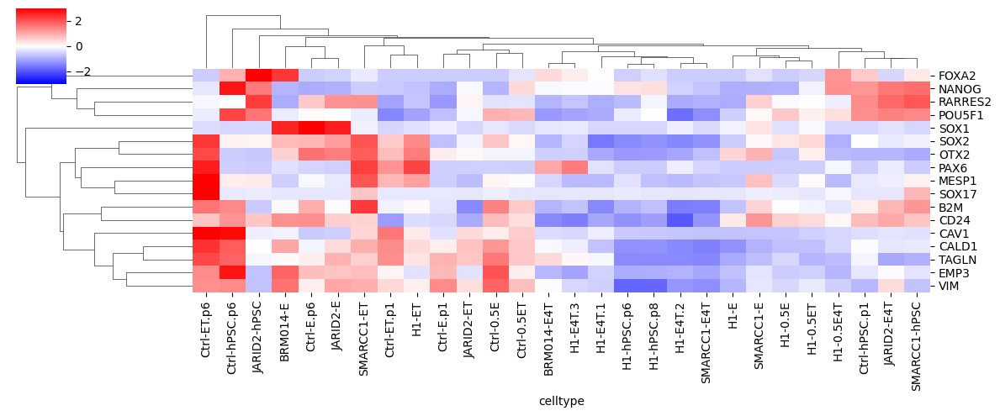

In [14]:
import seaborn as sns
sns.clustermap(expr, cmap='bwr',vmin=-3, vmax=3, figsize=[12,5], xticklabels=True, yticklabels=True)


/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/scanpy/tools/_utils.py:40: UserWarning: You’re trying to run this on 18084 dimensions of `.X`, if you really want this, set `use_rep='X'`.
         Falling back to preprocessing with `sc.pp.pca` and default params.
  warnings.warn(


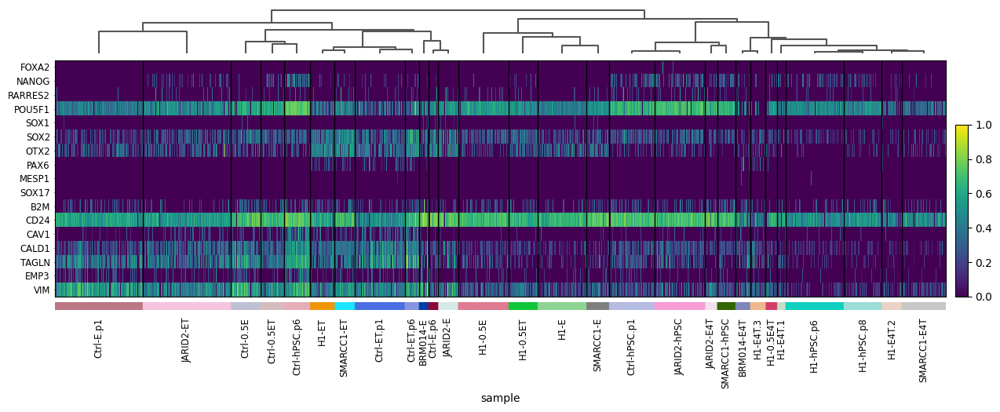

In [15]:
sc.pl.heatmap(adata_merged, 
              var_names= ['FOXA2','NANOG','RARRES2','POU5F1','SOX1','SOX2','OTX2','PAX6','MESP1','SOX17','B2M','CD24','CAV1','CALD1','TAGLN','EMP3','VIM'], 
              groupby='sample', swap_axes=True, show_gene_labels=True,
              dendrogram=True,standard_scale="var",figsize=[15,5]
             )

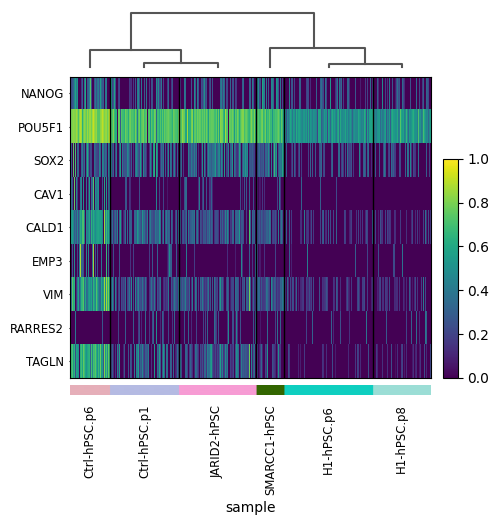

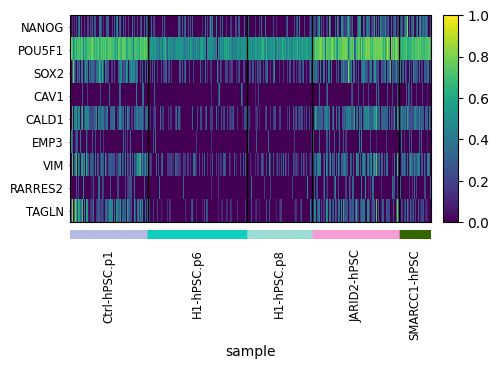

7553

In [16]:
adata_merged.obs['is_hPSC'] = adata_merged.obs['sample'].str.contains('hPSC')
hPSC_merged = adata_merged[adata_merged.obs['is_hPSC']].copy()

goi= ['NANOG','POU5F1','SOX2','CAV1','CALD1', 'EMP3','VIM','RARRES2','TAGLN']
sc.tl.dendrogram(hPSC_merged, groupby='sample', var_names=goi)

sc.pl.heatmap(hPSC_merged, 
              var_names= goi, 
              groupby='sample', swap_axes=True, show_gene_labels=True,
              dendrogram=True,standard_scale="var",figsize=[5,5]
             )

sc.pl.heatmap(hPSC_merged[ hPSC_merged.obs['sample']!='Ctrl-hPSC.p6' ].copy(), 
              var_names= goi, 
              groupby='sample', swap_axes=True, show_gene_labels=True,
              dendrogram=False,standard_scale="var",figsize=[5,3]
             )

del hPSC_merged
import gc
gc.collect()

# drop outlier samples and train scvi

In [17]:
import scvi

adata_merged = adata_merged[ adata_merged.obs['sample']!='Ctrl-hPSC.p6' ].copy()
sc.pp.highly_variable_genes(adata_merged, n_top_genes=1000, batch_key="batch")

scvi.model.SCVI.setup_anndata(
    adata_merged, layer="counts",
    batch_key='pool',
    categorical_covariate_keys = ["background"],
    continuous_covariate_keys  = ["pct_counts_mt", "log1p_n_genes_by_counts", "log1p_total_counts"],
)

model = scvi.model.SCVI(adata_merged, n_hidden=128, n_latent=30, n_layers=2)
model.train(max_epochs=40)



/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/docrep/decorators.py:43: SyntaxWarning: 'param_categorical_covariate_keys' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/docrep/decorators.py:43: SyntaxWarning: 'param_continuous_covariate_keys' is not a valid key!
  doc = func(self, args[0].__doc__, *args[1:], **kwargs)
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python3 /sha

Epoch 40/40: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [06:16<00:00, 10.44s/it, v_num=1, train_loss_step=7.77e+3, train_loss_epoch=7.82e+3]

`Trainer.fit` stopped: `max_epochs=40` reached.



poch 40/40: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [06:16<00:00,  9.41s/it, v_num=1, train_loss_step=7.77e+3, train_loss_epoch=7.82e+3]

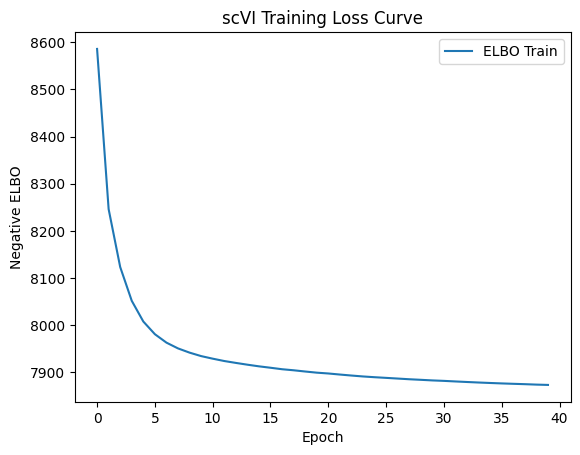

In [18]:
import matplotlib.pyplot as plt

plt.plot(model.history['elbo_train'], label='ELBO Train')
plt.xlabel('Epoch')
plt.ylabel('Negative ELBO')
plt.legend()
plt.title('scVI Training Loss Curve')
plt.show()

In [19]:
adata_merged.obsm['scvi_rep'] = model.get_latent_representation()
sc.pp.neighbors(adata_merged, use_rep='scvi_rep', n_neighbors=30)

sc.tl.umap(adata_merged, min_dist=0.3)
adata_merged.obsm['X_scvi_map'] = adata_merged.obsm['X_umap'].copy()

sc.tl.leiden(adata_merged, key_added='leiden0.3', resolution=0.3, flavor="igraph", n_iterations=2)
sc.tl.leiden(adata_merged, key_added='leiden0.5', resolution=0.5, flavor="igraph", n_iterations=2)
sc.tl.leiden(adata_merged, key_added='leiden0.7', resolution=0.7, flavor="igraph", n_iterations=2)

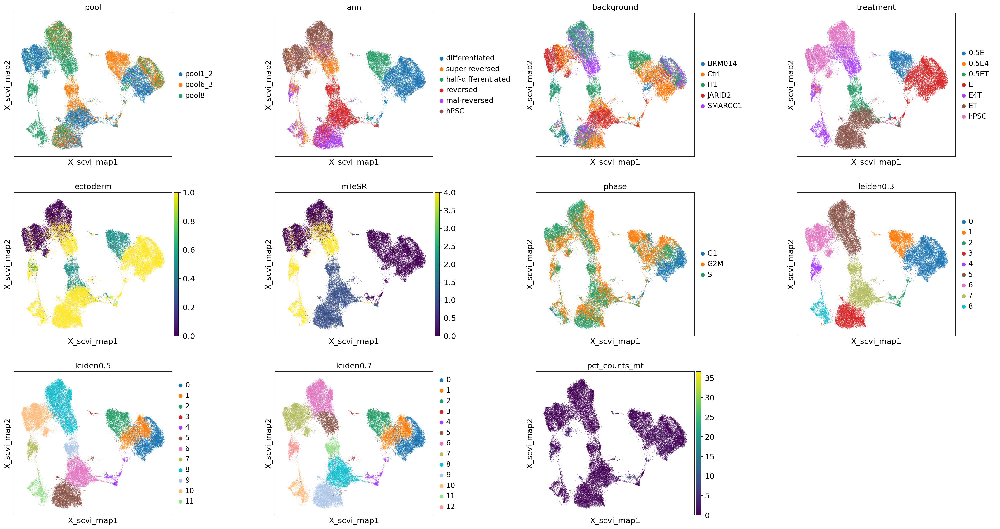

In [20]:
sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(
    adata_merged, 
    basis='X_scvi_map', 
    color=['pool','ann','background','treatment','ectoderm','mTeSR','phase',
           'leiden0.3', 'leiden0.5','leiden0.7','pct_counts_mt'], 
    wspace=0.5
)

In [99]:
model.save('scvi-model-250501', overwrite=True)

In [21]:
sc.tl.rank_genes_groups(adata_merged, groupby='leiden0.5')

In [28]:
# MT- genes enriched
sc.get.rank_genes_groups_df(adata_merged, group='4').query('logfoldchanges>0 & pvals_adj<0.05').head(20)

,names,scores,logfoldchanges,pvals,pvals_adj
0,FGFR1,36.558285,1.517497,6.084026e-230,1.727214e-228
1,LAMA5,35.226566,2.322090,1.812139e-216,4.635181e-215
2,ANKRD10,34.625893,2.092892,1.316823e-210,3.188102e-209
3,PAPLN,34.407570,3.042100,2.414978e-208,5.738826e-207
4,ABCA1,33.666973,2.166548,2.619746e-201,6.019756e-200
5,PILRB,32.150139,2.272339,1.306044e-186,2.686974e-185
6,SYNGAP1,32.070965,2.312161,7.361875e-186,1.509435e-184
7,CCNL2,32.029491,2.193104,1.785971e-185,3.649434e-184
8,OGT,27.867922,1.932411,7.007033e-147,1.079346e-145
9,RABGAP1L,27.292496,1.386226,7.980324e-142,1.187787e-140


In [31]:
adata_merged = adata_merged[ adata_merged.obs['leiden0.5'] !='4' ].copy()

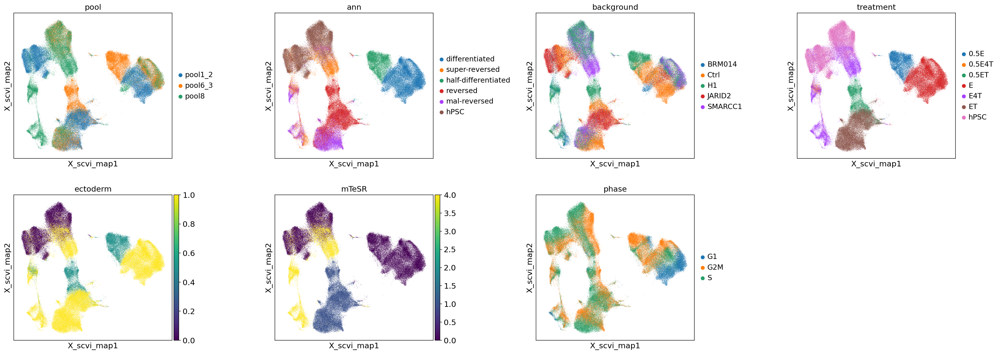

In [32]:
sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['pool','ann','background','treatment','ectoderm','mTeSR','phase'], wspace=0.5)

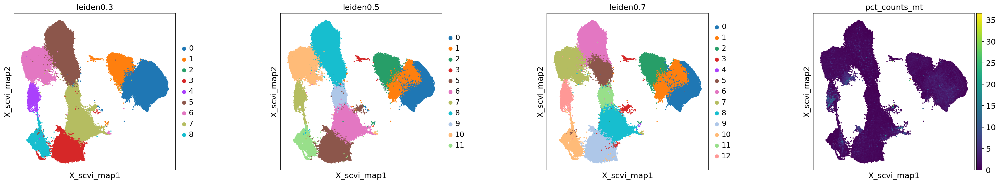

In [33]:
sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['leiden0.3', 'leiden0.5','leiden0.7','pct_counts_mt' ], cmap='viridis', wspace=0.5, size=20, add_outline=False)


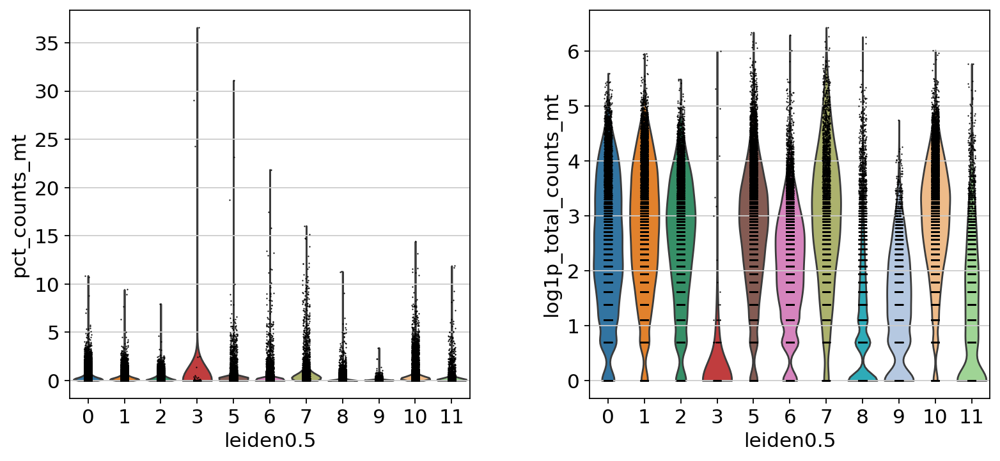

In [34]:
sc.pl.violin(adata_merged, groupby='leiden0.5', keys=[ 'pct_counts_mt','log1p_total_counts_mt'])

In [35]:
adata_merged = adata_merged[adata_merged.obs['pct_counts_mt'] <10].copy()

In [36]:
sc.pp.highly_variable_genes(adata_merged, n_top_genes=1000, batch_key="batch")

scvi.model.SCVI.setup_anndata(
    adata_merged, layer="counts",
    batch_key='pool',
    categorical_covariate_keys = ["background"],
    continuous_covariate_keys  = ["pct_counts_mt", "log1p_n_genes_by_counts", "log1p_total_counts"],
)

model = scvi.model.SCVI(adata_merged, n_hidden=128, n_latent=30, n_layers=2)
model.train(max_epochs=40)

/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python3 /share/software/user/open/py-jupyterlab/4.3.2_py312 ...
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python3 /share/software/user/open/py-jupyterlab/4.3.2_py312 ...
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dat

Epoch 40/40: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [05:48<00:00,  9.33s/it, v_num=1, train_loss_step=8.06e+3, train_loss_epoch=7.9e+3]

`Trainer.fit` stopped: `max_epochs=40` reached.



poch 40/40: 100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [05:48<00:00,  8.72s/it, v_num=1, train_loss_step=8.06e+3, train_loss_epoch=7.9e+3]

In [37]:
adata_merged.obsm['scvi_rep'] = model.get_latent_representation()
sc.pp.neighbors(adata_merged, use_rep='scvi_rep', n_neighbors=30)

sc.tl.umap(adata_merged, min_dist=0.3)
adata_merged.obsm['X_scvi_map'] = adata_merged.obsm['X_umap'].copy()

sc.tl.leiden(adata_merged, key_added='leiden0.3', resolution=0.3, flavor="igraph", n_iterations=2)
sc.tl.leiden(adata_merged, key_added='leiden0.5', resolution=0.5, flavor="igraph", n_iterations=2)
sc.tl.leiden(adata_merged, key_added='leiden0.7', resolution=0.7, flavor="igraph", n_iterations=2)

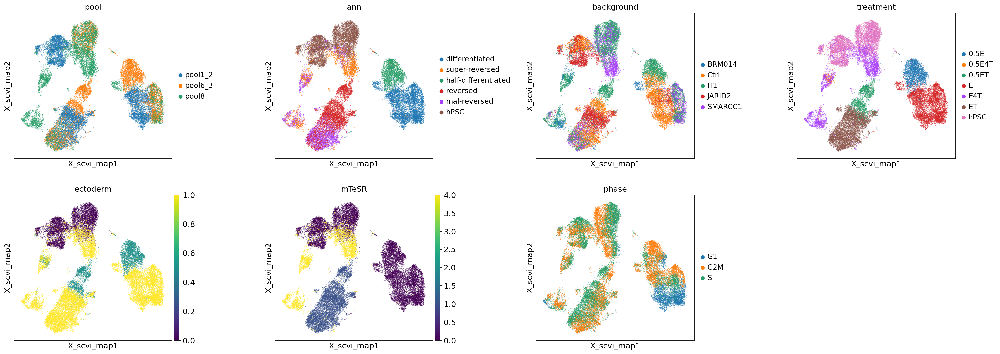

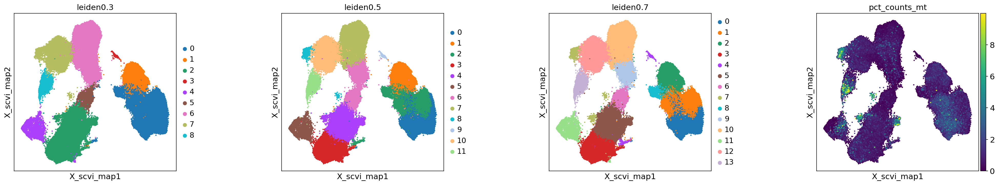

In [38]:
sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['pool','ann','background','treatment','ectoderm','mTeSR','phase'], wspace=0.5)

sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['leiden0.3', 'leiden0.5','leiden0.7','pct_counts_mt' ], cmap='viridis', wspace=0.5, size=20, add_outline=False)


In [49]:
sc.tl.rank_genes_groups(adata_merged, groupby='leiden0.7')

In [56]:
# MT- genes enriched
sc.get.rank_genes_groups_df(adata_merged, group='7').query('logfoldchanges>0 & pvals_adj<0.05').head(20)

,names,scores,logfoldchanges,pvals,pvals_adj
0,MT-ATP6,85.293694,3.810001,0.000000e+00,0.000000e+00
1,MT-CO3,83.964546,4.028100,0.000000e+00,0.000000e+00
2,MT-CO2,80.333893,3.862327,0.000000e+00,0.000000e+00
3,MT-ND4,73.305435,3.730381,0.000000e+00,0.000000e+00
4,MT-ND3,64.386986,3.218681,0.000000e+00,0.000000e+00
5,MT-CYB,62.668312,3.834540,0.000000e+00,0.000000e+00
6,SCD,59.049870,1.707354,0.000000e+00,0.000000e+00
7,MT-ND4L,56.154369,4.015430,0.000000e+00,0.000000e+00
8,SFRP2,54.345871,2.326583,0.000000e+00,0.000000e+00
9,DHCR24,50.924129,1.923282,0.000000e+00,0.000000e+00


In [57]:
# stress-induced
sc.get.rank_genes_groups_df(adata_merged, group='4').query('logfoldchanges>0 & pvals_adj<0.05').head(20)

,names,scores,logfoldchanges,pvals,pvals_adj
0,HIST1H1B,7.741933,1.036730,1.123585e-13,7.256754e-13
1,GSTP1,7.157819,0.732856,5.067656e-12,2.960061e-11
2,PHLDA3,6.802141,2.354453,4.651890e-11,2.566345e-10
3,BTG2,6.305730,3.200808,8.911335e-10,4.466535e-09
4,JUND,6.249823,1.040060,1.228384e-09,6.077728e-09
5,PFN1,6.186606,0.530442,1.761558e-09,8.584214e-09
6,RHOB,6.024985,1.568480,4.391826e-09,2.066661e-08
7,PMAIP1,5.859465,0.853083,1.095651e-08,4.962122e-08
8,MARCKSL1,5.668458,0.577250,3.072832e-08,1.327816e-07
9,IER5,5.641091,2.310339,3.559436e-08,1.531133e-07


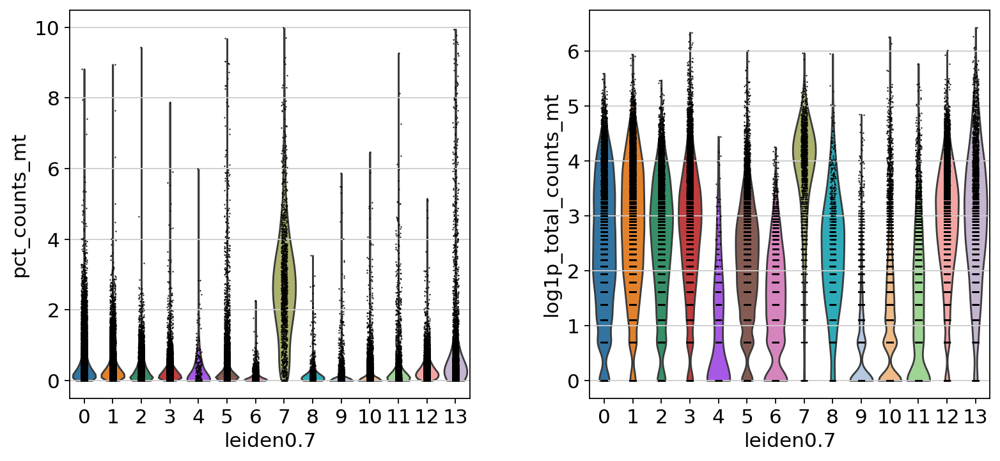

In [59]:
sc.pl.violin(adata_merged, groupby='leiden0.7', keys=[ 'pct_counts_mt','log1p_total_counts_mt'])

In [60]:
adata_merged = adata_merged[ adata_merged.obs['leiden0.7'] !='4' ].copy()
adata_merged = adata_merged[ adata_merged.obs['leiden0.7'] !='7' ].copy()

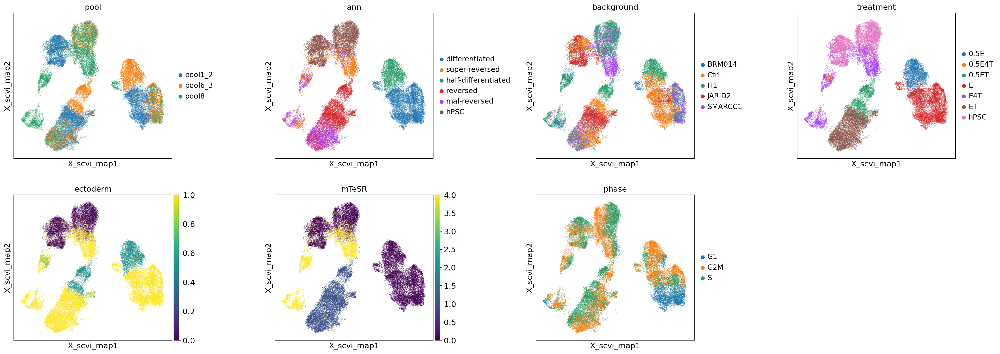

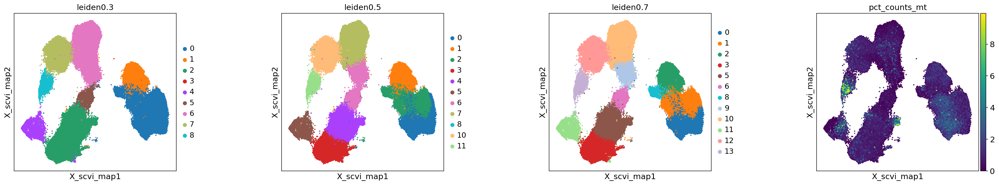

In [61]:
sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['pool','ann','background','treatment','ectoderm','mTeSR','phase'], wspace=0.5)

sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['leiden0.3', 'leiden0.5','leiden0.7','pct_counts_mt' ], cmap='viridis', wspace=0.5, size=20, add_outline=False)


In [63]:
sc.pp.highly_variable_genes(adata_merged, n_top_genes=1000, batch_key="batch")

scvi.model.SCVI.setup_anndata(
    adata_merged, layer="counts",
    batch_key='pool',
    categorical_covariate_keys = ["background"],
    continuous_covariate_keys  = ["pct_counts_mt", "log1p_n_genes_by_counts", "log1p_total_counts"],
)

model = scvi.model.SCVI(adata_merged, n_hidden=128, n_latent=30, n_layers=2)
model.train(max_epochs=40)



/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python3 /share/software/user/open/py-jupyterlab/4.3.2_py312 ...
GPU available: True (cuda), used: True
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/lightning/fabric/plugins/environments/slurm.py:204: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python3 /share/software/user/open/py-jupyterlab/4.3.2_py312 ...
LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/scratch/users/chensj16/venvs/scvi/lib/python3.12/site-packages/lightning/pytorch/trainer/connectors/data_connector.py:425: The 'train_dat

Epoch 40/40: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [05:58<00:00,  9.22s/it, v_num=1, train_loss_step=7.61e+3, train_loss_epoch=7.96e+3]

`Trainer.fit` stopped: `max_epochs=40` reached.



poch 40/40: 100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 40/40 [05:58<00:00,  8.97s/it, v_num=1, train_loss_step=7.61e+3, train_loss_epoch=7.96e+3]

In [64]:
adata_merged.obsm['scvi_rep'] = model.get_latent_representation()
sc.pp.neighbors(adata_merged, use_rep='scvi_rep', n_neighbors=30)

sc.tl.umap(adata_merged, min_dist=0.3)
adata_merged.obsm['X_scvi_map'] = adata_merged.obsm['X_umap'].copy()

sc.tl.leiden(adata_merged, key_added='leiden0.3', resolution=0.3, flavor="igraph", n_iterations=2)
sc.tl.leiden(adata_merged, key_added='leiden0.5', resolution=0.5, flavor="igraph", n_iterations=2)
sc.tl.leiden(adata_merged, key_added='leiden0.7', resolution=0.7, flavor="igraph", n_iterations=2)

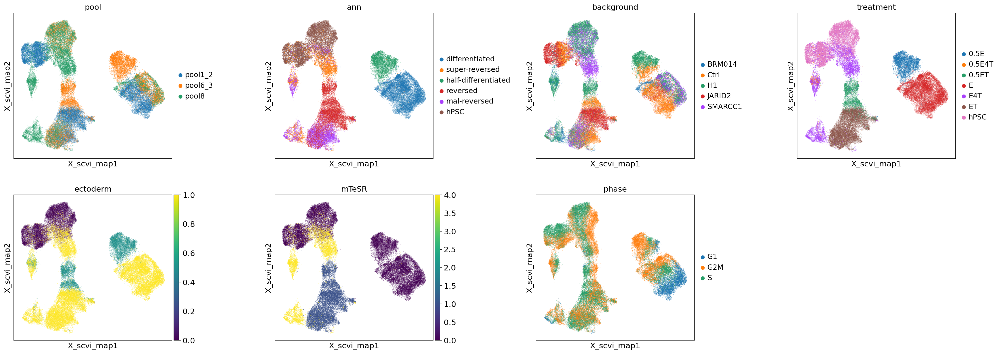

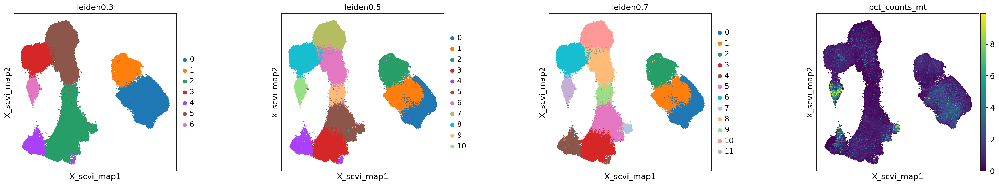

In [65]:
sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['pool','ann','background','treatment','ectoderm','mTeSR','phase'], wspace=0.5)

sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['leiden0.3', 'leiden0.5','leiden0.7','pct_counts_mt' ], cmap='viridis', wspace=0.5, size=20, add_outline=False)


In [66]:
sc.tl.rank_genes_groups(adata_merged, groupby='leiden0.7')

In [67]:
# MT- genes enriched
sc.get.rank_genes_groups_df(adata_merged, group='7').query('logfoldchanges>0 & pvals_adj<0.05').head(20)

,names,scores,logfoldchanges,pvals,pvals_adj
0,AASS,38.005672,1.880727,4.763928e-198,1.325398e-195
1,MT-CO3,34.067616,2.279595,9.188573e-171,1.613264e-168
2,MT-ND3,33.261635,2.230981,4.394050e-165,7.158739e-163
3,MT-ATP6,31.937492,2.032184,5.335618e-156,7.254836e-154
4,MT-CO2,30.678406,2.116088,3.690614e-147,4.069577e-145
5,MT-ND4,26.634092,1.910503,3.515192e-119,2.254210e-117
6,VCAN,24.578203,1.493025,3.147183e-105,1.489886e-103
7,KIF1A,21.180452,1.123961,7.075247e-83,2.073724e-81
8,NOTCH3,20.483877,1.271228,1.967536e-78,5.209505e-77
9,CENPF,20.170574,1.324215,1.872915e-76,4.723822e-75


In [70]:
adata_merged = adata_merged[ adata_merged.obs['leiden0.7'] !='7' ].copy()

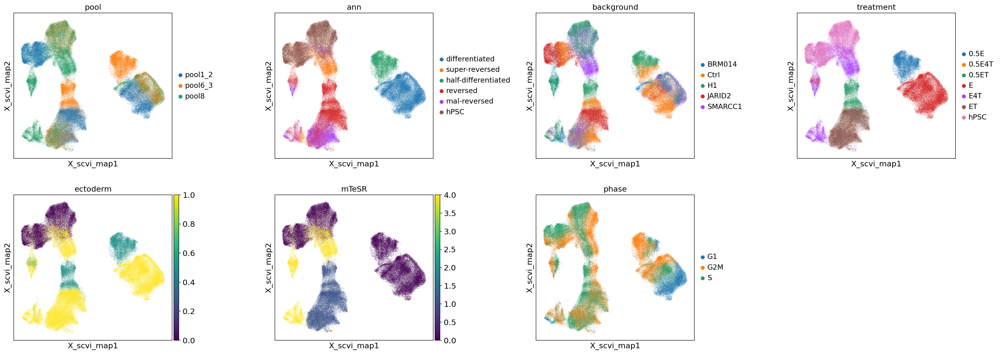

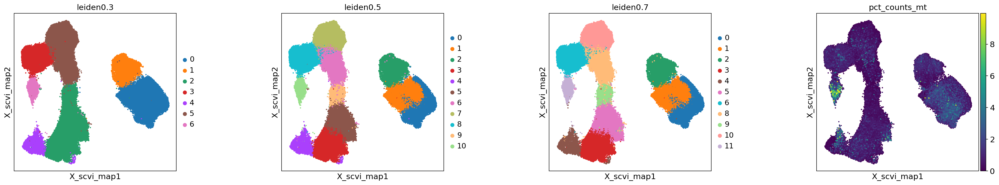

In [72]:
sc.set_figure_params(figsize=[5,5])
sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['pool','ann','background','treatment','ectoderm','mTeSR','phase'], wspace=0.5)

sc.pl.embedding(adata_merged, basis='X_scvi_map', color=['leiden0.3', 'leiden0.5','leiden0.7','pct_counts_mt' ], cmap='viridis', wspace=0.5, size=20, add_outline=False)


In [71]:
adata_merged.write_h5ad('adata_merged.pp1.v250501.h5ad')

In [2]:
adata_merged=  sc.read_h5ad('adata_merged.pp1.v250501.h5ad')